<a href="https://colab.research.google.com/github/kimsang-kyu/Maestro_sanfancisco/blob/main/San_francisco_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 샌프란시스코 범죄 분석 및 예측

![](https://t1.daumcdn.net/cfile/blog/2573CB45536B36CA15?original)


#### 팀명 :
#### 팀원 : 김상규, 박민경, 정성혁, 황인규

Kernel

https://www.kaggle.com/data13/crime-prediction-in-san-francisco

https://www.kaggle.com/yannisp/sf-crime-analysis-prediction

https://www.kaggle.com/abhimicro3/eda-of-san-francisco-crime-classification

## 개요

https://www.kaggle.com/c/sf-crime

> 샌프란시스코 범죄 분석 및 예측

 - 과거 범죄 유형 및 시간과 장소 등의 데이터를 분석해 미래에 발생할 수 있는 범죄를 예측

-  미래에 발생할 수 있는 범죄를 예측한 후, 범죄가 발생하기 전에 범죄자를 검거하여 범죄발생 건수 감소 유도

- 샌프란시스코 전 지역에서 발생한 범죄에 대해 12년간 범죄보고서를 수집한 데이터로 분석을 실시 및 사회적으로 이슈가 될 수 있는 중범죄들에 대해 분석 실시

## 기본 데이터 설명

### Data Load

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.offline as py
from matplotlib import cm

In [ ]:
#구글드라이브와 코랩 연동
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


data load 할때 날짜 형태로 변환

In [ ]:
train=pd.read_csv('/content/drive/My Drive/빅데이터마에스트로 과정/Final_EDA/train.csv',parse_dates=['Dates'])
train['Year']=train['Dates'].dt.year
train['Month']=train['Dates'].dt.month
train['Hour']=train['Dates'].dt.hour

In [ ]:
train.head()

,Dates,Category,Descript,DayOfWeek,PdDistrict,Resolution,Address,X,Y,Year,Month,Hour
0,2015-05-13 23:53:00,WARRANTS,WARRANT ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599,2015,5,23
1,2015-05-13 23:53:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599,2015,5,23
2,2015-05-13 23:33:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",VANNESS AV / GREENWICH ST,-122.424363,37.800414,2015,5,23
3,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,NORTHERN,NONE,1500 Block of LOMBARD ST,-122.426995,37.800873,2015,5,23
4,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,PARK,NONE,100 Block of BRODERICK ST,-122.438738,37.771541,2015,5,23


- Date : 2003~2015년까지의 데이터
- Category : 범죄 사건의 종류로 총 39개의 범죄종류가 있다.
 
Catergory | 설명
------|------
LARCENY/THEFT | 절도
OTHER OFFENSES    | 기타범죄
NON-CRIMINAL | 비범죄자
ASSAULT    | 폭행
DRUG/NARCOTIC | 약물/마약
VEHICLE THEFT    | 차량절도
VANDALISM | 공공 기물 파손
WARRANTS | 구속영장
BURGLARY| 절도/빈집털이
SUSPICIOUS OCC | 불법행위
MISSING PERSON    | 실종
ROBBERY    | 강도
FRAUD | 사기
FORGERY/COUNTERFEITING    | 위조
SECONDARY CODES    | 
WEAPON LAWS | 불법 총기 소유
PROSTITUTION    | 매춘
TRESPASS    | 무단침입
STOLEN PROPERTY | 도난
SEX OFFENSES FORCIBLE     | 강간
DISORDERLY CONDUCT    | 치안, 문란행위
DRUNKENNESS    | 만취상태
RECOVERED VEHICLE     | 도난차량
KIDNAPPING    | 납치
DRIVING UNDER THE INFLUENCE     | 음주운전
RUNAWAY    | 도주
LIQUOR LAWS     | 주류법 위반
ARSON    | 방화
LOITERING     | 가출
EMBEZZLEMENT     | 도용
SUICIDE     | 자살
FAMILY OFFENSES    | 가족범죄
BAD CHECKS     | 부도 수표
BRIBERY     | 뇌물
EXTORTION     | 강요, 강탈
SEX OFFENSES NON FORCIBLE     | 미성년자 범죄
GAMBLING     | 도박
PORNOGRAPHY/OBSCENE MAT     | 포르노물
TREA    | 불법치료

- Descript : 범죄 사건에 대한 자세한 설명
- DayOfweek : 요일(월요일, 화요일, 수요일, 목요일, 금요일, 토요일, 일요일)
- PdDistrict : 경찰서 구역 이름

PdDistrict |
------|
SOUTHERN
MISSION
NORTHERN
BAYVIEW
CENTRAL
TENDERLOIN
INGLESIDE
TARAVAL
PARK
RICHMOND

 - Resolution : 범죄 사건이 해결 된 방법

Resolution  |
------ |
NONE   
ARREST, BOOKED    
ARREST, CITED | 
LOCATED    | 
PSYCHOPATHIC CASE  | 
UNFOUNDED    | 
JUVENILE BOOKED  | 
COMPLAINANT REFUSES TO PROSECUTE | 
DISTRICT ATTORNEY REFUSES TO PROSECUTE | 
NOT PROSECUTED | 
JUVENILE CITED     | 
PROSECUTED BY OUTSIDE AGENCY    | 
EXCEPTIONAL CLEARANCE   | 
FORGERY/COUNTERFEITING    | 
JUVENILE ADMONISHED    | 
JUVENILE DIVERTED  | 
CLEARED-CONTACT JUVENILE FOR MORE INFO    | 
PROSECUTED FOR LESSER OFFENSE   | 

- Address : 범죄 사건의 대략적인 주소
  - 약 2만개의 거리가 있음
- X :  경도

- Y :  위도 

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 878049 entries, 0 to 878048
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   Dates       878049 non-null  datetime64[ns]
 1   Category    878049 non-null  object        
 2   Descript    878049 non-null  object        
 3   DayOfWeek   878049 non-null  object        
 4   PdDistrict  878049 non-null  object        
 5   Resolution  878049 non-null  object        
 6   Address     878049 non-null  object        
 7   X           878049 non-null  float64       
 8   Y           878049 non-null  float64       
 9   Year        878049 non-null  int64         
 10  Month       878049 non-null  int64         
 11  Hour        878049 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(3), object(6)
memory usage: 80.4+ MB


 데이터 타입과 정보를 보여준다.

In [ ]:
print('The shape of the training data is:',train.shape)

The shape of the training data is: (878049, 12)


데이터의 총 개수를 보여준다.

### 결측값 및 이상치 확인

In [ ]:
train.columns[train.isnull().any()]

Index([], dtype='object')

결측값이 한개라도 있으면 True가 뜨고, 없다면 False가 나온다. 하지만 결측값은 없기 때문에 전부다 False가 나온다. 각 변수별로 결측치는 없는 것으로 확인된다.

#### 이상치확인

{'boxes': [<matplotlib.lines.Line2D at 0x7f11d79ae210>],
 'caps': [<matplotlib.lines.Line2D at 0x7f11d8159150>,
 'fliers': [<matplotlib.lines.Line2D at 0x7f11d8151290>],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x7f11d8159d10>],
 'whiskers': [<matplotlib.lines.Line2D at 0x7f11d8065650>,
  <matplotlib.lines.Line2D at 0x7f11d8065b90>]}

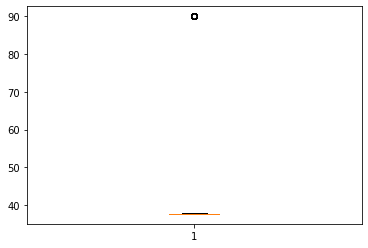

In [ ]:
plt.boxplot(train['Y'])

![대체 텍스트](https://www.kaggleusercontent.com/kf/9444725/eyJhbGciOiJkaXIiLCJlbmMiOiJBMTI4Q0JDLUhTMjU2In0..NDK3hzv2THXDNba-9ol6YA.lIcQlsrCw0deot5P6sITyH89MzXqKevZbWsR0XexomHzUNxY4G3CNujYyeDl4QYpcyxDJGS7fwIqKBYZQcQmynrRf29ofsTa9Su0zhAhittQFLHjqTnF2seAwfJCRn8KBwYd3RkEPGf8nYYk7I-5lzXPReYMZFIH0tuqBHJhLIzQ1CkVFXZkyCE5PhxSxbSTY1uL3a7bILM_hMNkK8xu2mCHRUBnBFcIROfXEL6uHW9L9sT0dNYG6LPw12UHxyiH7eNhCZcBKumRJk4LXVVDe0K76aPZWK9GMR99qVPL5n64h89rum8DmM9jpEBNaBgg8HSJgh1TCNOhhHpWiPl_IpII5TwMHY-K2tZCHe0q4kHpYxHSxFVB8K3Qs9zpxeAYrKwAUGbQI_TMjfiDSSlJyCIks43eeayY9ZxbWUahZPIDP_ySAzEjoNOwQHa3WS68o1DSJePcgDrxB3vTxEvDWbPKKf5sx4AsPwIPxttrnhVb6fYd_n1cPKJAFcriWwzfGjgbkNiYfs5Ik_iS0kXsBpV_2Yx4jMNFy0pn05wmJWCC4adxocjbuWGSgp1eQCahQY2khjK8bIaqONJIQKUTWtILr-j4DI4mvn7cHOss-3areSJbro7HDKHCVdXA3DmcWHT3YjRdfu_gnHP7izgRqlpVmzFYWiNhz6j4nzHqNQE.TkhFqCKqMiCA8l4VRbyerA/__results___files/__results___11_0.png)


 > 지도를 통하여 확인을 할 수 있음

결측치는 없었고, 잘못된 데이터가 있는지 확인하였다. 나머지 데이터는 잘못된 데이터가 없었지만, 위도에 대한 잘못된 데이터가 존재하였다.
위도에 대해서 나무상자그림을 그렸을 때, 샌프란시스코의 위도는 평균적으로 37˚가 나오지만 위도가 90˚(북극지점)(으)로 찍힌 데이터가 있는 것을 확인하였다.

In [ ]:
train[train['Y'] > 50 ].count()

Dates         67
Category      67
Descript      67
DayOfWeek     67
PdDistrict    67
Resolution    67
Address       67
X             67
Y             67
Year          67
Month         67
Hour          67
dtype: int64

그래서 위도가 50˚보다 위에 있는 데이터의 개수를 확인하였고, 총 67개의 데이터가 이상치로 판단되었다.

In [ ]:
train = train[train['Y'] < 50]

그래서 이상치를 제거하기 위해서 위도가 50도 이하인 값을 다시 train데이터에 반환하였다.

### Category

In [ ]:
train['Category'].unique() #총 39개의 범죄종류 확인

array(['WARRANTS', 'OTHER OFFENSES', 'LARCENY/THEFT', 'VEHICLE THEFT',
       'VANDALISM', 'NON-CRIMINAL', 'ROBBERY', 'ASSAULT', 'WEAPON LAWS',
       'BURGLARY', 'SUSPICIOUS OCC', 'DRUNKENNESS',
       'FORGERY/COUNTERFEITING', 'DRUG/NARCOTIC', 'STOLEN PROPERTY',
       'SECONDARY CODES', 'TRESPASS', 'MISSING PERSON', 'FRAUD',
       'KIDNAPPING', 'RUNAWAY', 'DRIVING UNDER THE INFLUENCE',
       'SEX OFFENSES FORCIBLE', 'PROSTITUTION', 'DISORDERLY CONDUCT',
       'ARSON', 'FAMILY OFFENSES', 'LIQUOR LAWS', 'BRIBERY',
       'EMBEZZLEMENT', 'SUICIDE', 'LOITERING',
       'SEX OFFENSES NON FORCIBLE', 'EXTORTION', 'GAMBLING', 'BAD CHECKS',
       'TREA', 'RECOVERED VEHICLE', 'PORNOGRAPHY/OBSCENE MAT'],
      dtype=object)

In [ ]:
category=train['Category'].value_counts().sort_values(ascending=False).reset_index() #내림차순 
category.columns=['Category','Count']
category

,Category,Count
0,LARCENY/THEFT,174885
1,OTHER OFFENSES,126165
2,NON-CRIMINAL,92300
3,ASSAULT,76872
4,DRUG/NARCOTIC,53971
5,VEHICLE THEFT,53772
6,VANDALISM,44724
7,WARRANTS,42206
8,BURGLARY,36754
9,SUSPICIOUS OCC,31412


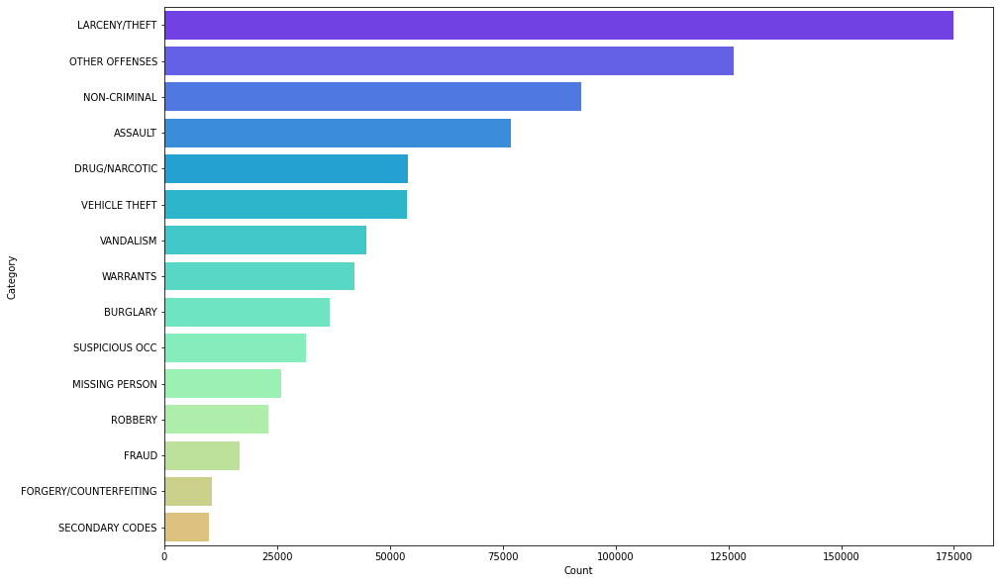

In [ ]:
category15 = category.head(15)
current_palette_4 = sns.color_palette('rainbow', 20)
sns.set_palette(current_palette_4)

plt.figure(figsize=(15, 10)) #그래프사이즈
sns.barplot(data=category15,x='Count',y='Category') #data, x, y

Category는 범죄데이터로 value_counts()를 이용하여 각 범죄종류가 얼마나 발생하였는지 알 수 있다.
 
 절도, 기타범죄, 비범죄, 폭행, 약물/마약 순으로 나타났다.

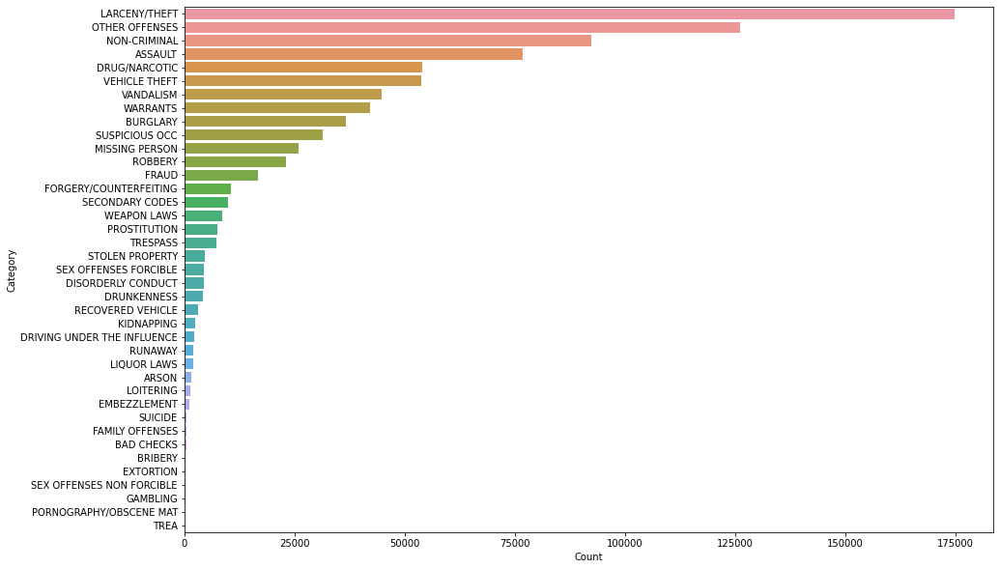

In [ ]:
current_palette_4 = sns.color_palette('rainbow', 20)
sns.set_palette(current_palette_4)

plt.figure(figsize=(15, 10)) #그래프사이즈
sns.barplot(data=category,x='Count',y='Category') #data, x, y

카테고리에서 범죄종류에 대한 개수를 그래프화 한 것이다. 그래프로 보면 절도가 압도적으로 많은 것으로 볼 수 있다.

### Descript

In [ ]:
train['Descript'].value_counts()

GRAND THEFT FROM LOCKED AUTO                            60013
LOST PROPERTY                                           31729
BATTERY                                                 27439
STOLEN AUTOMOBILE                                       26893
DRIVERS LICENSE, SUSPENDED OR REVOKED                   26833
                                                        ...  
PUSH-CART PEDDLER PERMIT VIOLATION                          1
DOG, FIGHTING;  OWNING, FIGHTING, OR ATTENDING FIGHT        1
ASSAULT, AGGRAVATED, ON POLICE OFFICER, W/ SEMI AUTO        1
ASSAULT, AGGRAVATED, ON POLICE OFFICER, W/ FULL AUTO        1
ASSAULT OR ATTEMPTED MURDER UPON GOV'T OFFICERS             1
Name: Descript, Length: 879, dtype: int64

Descript는 범죄종류에 대한 설명으로 총 879개의 종류로 나누어져있다.

###주소별

In [ ]:
def street_addr(x):
    street=x.split(' ')
    return (' '.join(street[-2:])) #공백을 기준으로 다 분리하고 분리한것중에 뒤에서 두개만 조인해서 리턴한다.

In [ ]:
train['addr']=train['Address'].apply(lambda x:street_addr(x)) #street_addr을 나눈값을 바로 적용하기 위해서 apply와 lambda를 쓴다
train[['addr']].head()

,addr
0,LAGUNA ST
1,LAGUNA ST
2,GREENWICH ST
3,LOMBARD ST
4,BRODERICK ST


In [ ]:
train['addr'].value_counts()

MISSION ST    36826
MARKET ST     34366
BRYANT ST     30757
TURK ST       13078
EDDY ST       11604
              ...  
ELIM AL           1
MARCOS AV         1
SPRING AV         1
CHATHAM PL        1
LAKES DR          1
Name: addr, Length: 2038, dtype: int64

In [ ]:
###Category : 범죄 사건 카테고리 (train.csv에만 해당) 이것이 예측할 목표 변수입니다.
commo_crime=train['Category'].value_counts().sort_values(ascending=False).reset_index().head(10) 
#카테고리의 범주당 개수를 새주고 순서정렬, 인덱스를 리셋한다음 10개만 추출
commo_crime.columns=['Crime','Count'] #컬럼이름을 변경해줌
commo_crime

,Crime,Count
0,LARCENY/THEFT,174885
1,OTHER OFFENSES,126165
2,NON-CRIMINAL,92300
3,ASSAULT,76872
4,DRUG/NARCOTIC,53971
5,VEHICLE THEFT,53772
6,VANDALISM,44724
7,WARRANTS,42206
8,BURGLARY,36754
9,SUSPICIOUS OCC,31412


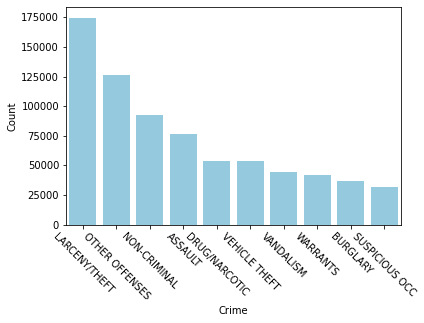

In [ ]:
plt.xticks(rotation = - 45 )
sns.barplot(data=commo_crime,x='Crime',y='Count',color='skyblue')

### 연도별 범죄 현황

In [ ]:
#연도별 범죄 현황
year_count=train['Year'].value_counts().reset_index().sort_values(by='index')
year_count.columns=['Year','Count']
year_count = year_count.set_index('Year')
year_count

,Count
Year,
2003,73888
2004,73407
2005,70741
2006,69909
2007,68015
2008,70174
2009,69000
2010,66542
2011,66619


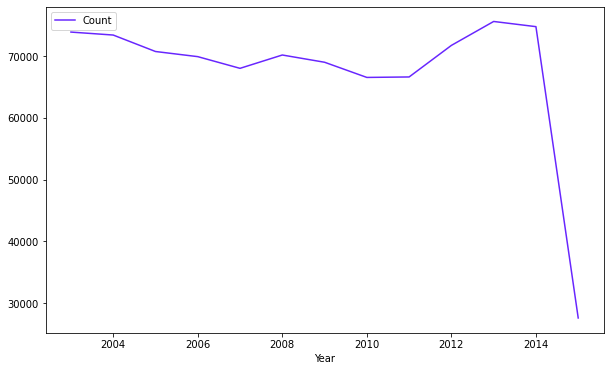

In [ ]:
#연도별 범죄 현황에 대한 그래프
year_count.plot(figsize = (10,6))

2015년 5월까지밖에 데이터를 보여준다.

### 월별 범죄 현황

In [ ]:
#월별 범죄 현황
month=train['Month'].value_counts().sort_values(ascending=False).reset_index()
month.columns=['Month','Count']
month = month.sort_values(by=['Month'])
month

,Month,Count
4,1,73534
8,2,70811
3,3,76317
2,4,78093
1,5,79640
7,6,70882
9,7,69969
10,8,68527
6,9,71978
0,10,80258


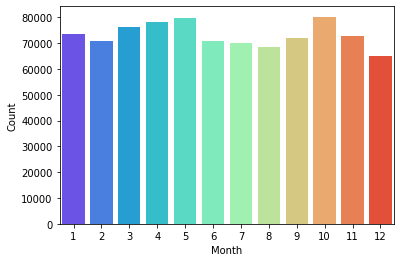

In [ ]:
current_palette_4 = sns.color_palette('rainbow', 12) #그래프 색깔을 지정
sns.set_palette(current_palette_4) #그래프에 색 적용

sns.barplot(data=month,x='Month',y='Count')

월별 범죄 현황에 대한 그래프로, 10월에 범죄가 제일 많이 발생하였으며, 8월에 제일 적게 발생했다.

### 요일별 범죄 현황

In [ ]:
DayOfWeek = train.groupby('DayOfWeek').count().iloc[:, 0]
DayOfWeek = DayOfWeek.reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday',
                               'Friday', 'Saturday','Sunday'])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



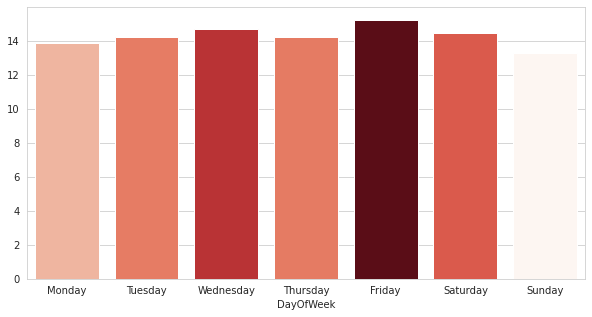

In [ ]:
plt.figure(figsize=(10, 5))
with sns.axes_style("whitegrid"):
    ax = sns.barplot(
        DayOfWeek.index, (DayOfWeek.values / DayOfWeek.values.sum()) * 100,
        orient='v',
        palette=cm.ScalarMappable(cmap='Reds').to_rgba(DayOfWeek.values))
    
#요일별 범죄수/전체 범죄수로 비율을 나타냄
#미세한 차이지만 금요일이 가장 많음

#이거 스택플랏써서 그려보기 

 - 요일별 범죄 현황에 대해서 범죄 비율을 나타낸다.
 - 금요일이 제일 빈도수가 많았다.
 - 금요일이 빈도수가 많은 이유가 술을 많이 먹기 때문이라고 예상했다.
 - 그래서 음주에 대한 범죄가 실제로 금요일에 많은지 알아보았다.

음주에 대한 요일별 범죄 발생수이다.

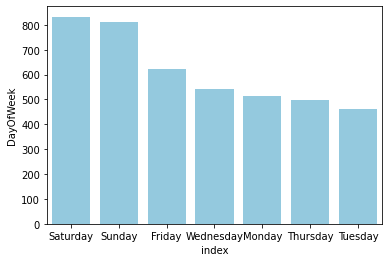

In [ ]:
#요일에 대한 음주?
train_drunk = train[train['Category']== 'DRUNKENNESS']
train_drunk.head()
drunk_week = train_drunk['DayOfWeek'].value_counts().reset_index()
# drunk_week.rename('Week','count')
sns.barplot(data=drunk_week,x='index',y='DayOfWeek',color = 'skyblue') 

In [ ]:
list = [6,7,5,3,1,4,2]
drunk_week['list'] = pd.DataFrame(list)
drunk_weeks = drunk_week.sort_values(by=['list'])
drunk_weeks.drop('list', axis =1)

,index,DayOfWeek
4,Monday,513
6,Tuesday,461
3,Wednesday,542
5,Thursday,496
2,Friday,622
0,Saturday,833
1,Sunday,813


그래프로 나타냈을때, 예상과는 다르게 토요일과 일요일에 음주와 관련된 범죄가 많이 발생했다. 금요일에 범죄가 많이 일어난 것에 대해 음주가 영향을 미치지 않는다고 판단했다.

### 시간별 범죄 현황

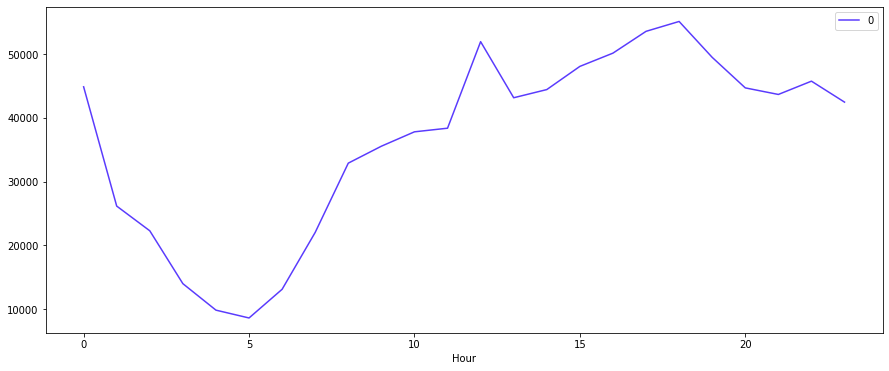

In [ ]:
tr_ct_hr = train[['Hour','Category']]
train_time = tr_ct_hr.groupby(['Hour']).size().to_frame()
train_time

train_time.plot(figsize = (15,6))
plt.show()

시간별로 범죄현황을 나타낸 그래프이다.

유동인구가 많이 나타나는 점심과 저녁시간에 범죄가 많이 발생하였고, 새벽에 범죄가 많이 발생했을 것이라고 예상했지만, 오히려 새벽에는 범죄가 다른시간에 비해 적었다.

### 경찰서 구역별 범죄 현황

In [ ]:
### PdDistrict : 경찰서 구역 이름
commo_dis=train['PdDistrict'].value_counts().sort_values(ascending=False).reset_index().head(10)
commo_dis.columns=['District','Count']
commo_dis

,District,Count
0,SOUTHERN,157174
1,MISSION,119907
2,NORTHERN,105284
3,BAYVIEW,89422
4,CENTRAL,85455
5,TENDERLOIN,81794
6,INGLESIDE,78841
7,TARAVAL,65592
8,PARK,49311
9,RICHMOND,45202


경찰서 구역별 범죄 현황이다.

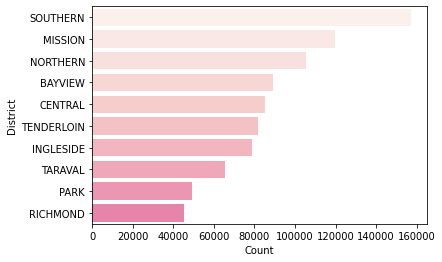

In [ ]:
current_palette_4 = sns.color_palette('RdPu', 20) 
sns.set_palette(current_palette_4)

sns.barplot(data=commo_dis,x='Count',y='District')

![링크 텍스트](https://www.kaggleusercontent.com/kf/9444725/eyJhbGciOiJkaXIiLCJlbmMiOiJBMTI4Q0JDLUhTMjU2In0..NDK3hzv2THXDNba-9ol6YA.lIcQlsrCw0deot5P6sITyH89MzXqKevZbWsR0XexomHzUNxY4G3CNujYyeDl4QYpcyxDJGS7fwIqKBYZQcQmynrRf29ofsTa9Su0zhAhittQFLHjqTnF2seAwfJCRn8KBwYd3RkEPGf8nYYk7I-5lzXPReYMZFIH0tuqBHJhLIzQ1CkVFXZkyCE5PhxSxbSTY1uL3a7bILM_hMNkK8xu2mCHRUBnBFcIROfXEL6uHW9L9sT0dNYG6LPw12UHxyiH7eNhCZcBKumRJk4LXVVDe0K76aPZWK9GMR99qVPL5n64h89rum8DmM9jpEBNaBgg8HSJgh1TCNOhhHpWiPl_IpII5TwMHY-K2tZCHe0q4kHpYxHSxFVB8K3Qs9zpxeAYrKwAUGbQI_TMjfiDSSlJyCIks43eeayY9ZxbWUahZPIDP_ySAzEjoNOwQHa3WS68o1DSJePcgDrxB3vTxEvDWbPKKf5sx4AsPwIPxttrnhVb6fYd_n1cPKJAFcriWwzfGjgbkNiYfs5Ik_iS0kXsBpV_2Yx4jMNFy0pn05wmJWCC4adxocjbuWGSgp1eQCahQY2khjK8bIaqONJIQKUTWtILr-j4DI4mvn7cHOss-3areSJbro7HDKHCVdXA3DmcWHT3YjRdfu_gnHP7izgRqlpVmzFYWiNhz6j4nzHqNQE.TkhFqCKqMiCA8l4VRbyerA/__results___files/__results___23_0.png)

> 경찰서구역별로 범죄 건수에 대한 밀도 그래프


 
 > 북동쪽에 위치한 SOUTHERN, MISSION 구역에서 범죄가 제일 많이 발생하였다.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.



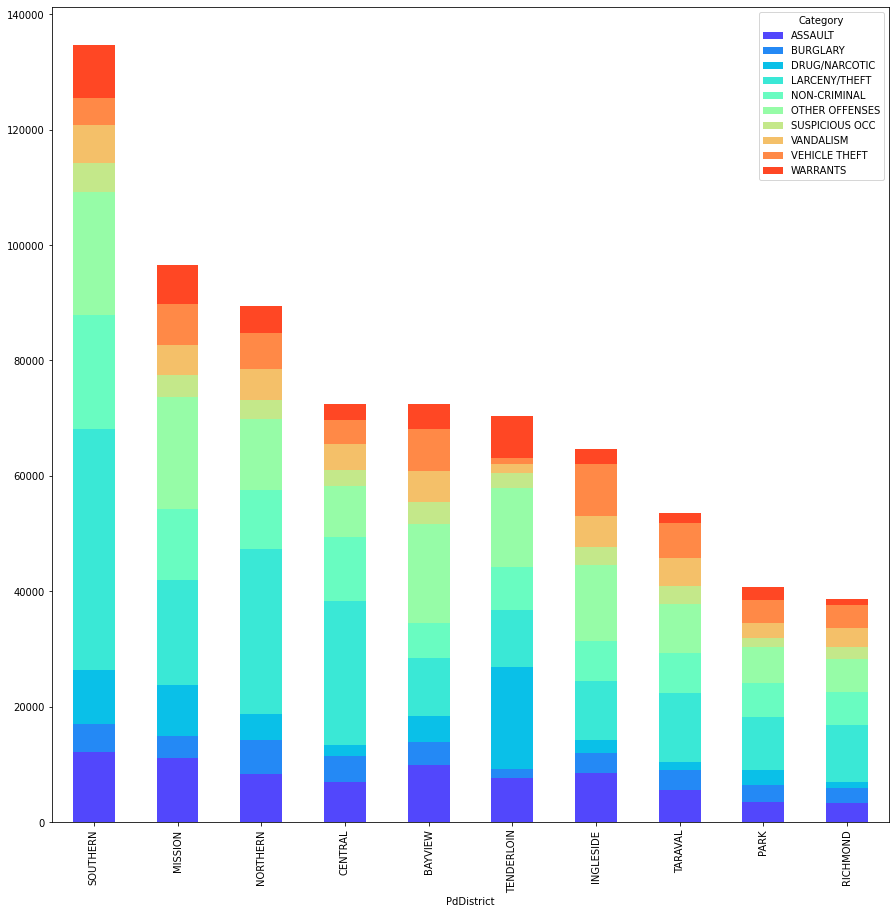

In [ ]:
df_cr=pd.DataFrame(train['Category'].value_counts())
df_cr.tail()
top10cc=pd.Series(df_cr.head(10).index)
top10cc
top10=train[train['Category'].isin(top10cc)]
top10.describe(include='all')

current_palette_4 = sns.color_palette('rainbow', 10) #그래프 색깔을 지정
sns.set_palette(current_palette_4) #그래프에 색 적용

tmp=pd.DataFrame(top10.groupby(['PdDistrict','Category']).size(), columns=['count'])
tmp.reset_index(inplace=True)
tmp=tmp.pivot(index='PdDistrict',columns='Category',values='count')
tmp['sum'] = tmp.sum(axis=1)
tmp = tmp.sort_values(by=['sum'],ascending=False)
tmp = tmp.drop('sum',axis =1)
fig, axes = plt.subplots(1,1,figsize=(15,15))
tmp.plot(ax=axes,kind='bar', stacked=True)

경찰서 구역별로 어떠한 범죄가 많이 발생하였는지 나누어보았다.

범죄수가 가장 많이 나타난 SOUTHERN에서는 LARCENY/THEFT가 가장 많이 발생했다.

### 해결방법

In [ ]:
resolution=train['Resolution'].value_counts().sort_values(ascending=False).reset_index().head(17) #내림차순 
resolution.columns=['Resolution','Count']
resolution

,Resolution,Count
0,NONE,526757
1,"ARREST, BOOKED",206384
2,"ARREST, CITED",76994
3,LOCATED,17101
4,PSYCHOPATHIC CASE,14533
5,UNFOUNDED,9584
6,JUVENILE BOOKED,5563
7,COMPLAINANT REFUSES TO PROSECUTE,3974
8,DISTRICT ATTORNEY REFUSES TO PROSECUTE,3934
9,NOT PROSECUTED,3714


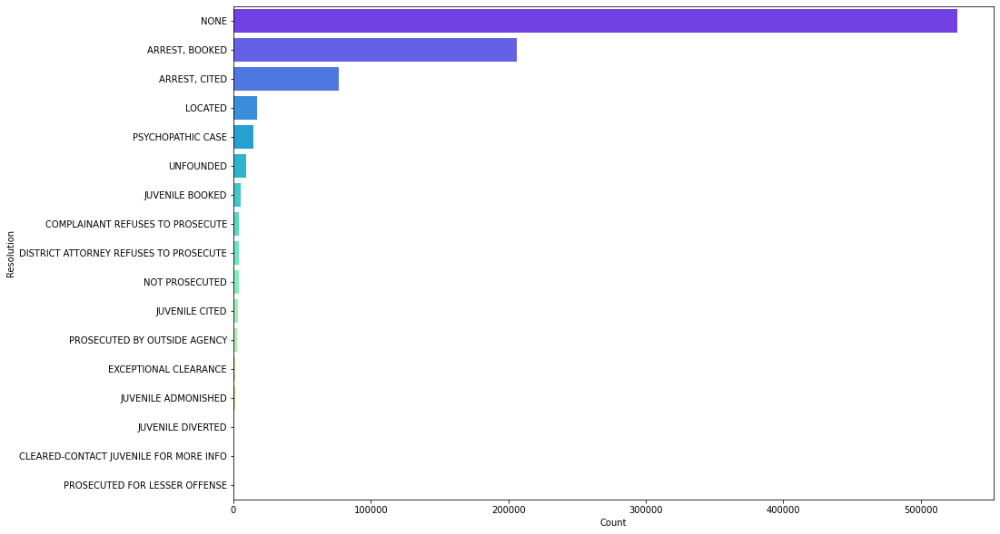

In [ ]:
current_palette_4 = sns.color_palette('rainbow', 20) #그래프 색깔을 지정
sns.set_palette(current_palette_4) #그래프에 색 적용
plt.figure(figsize=(15, 10)) #그래프사이즈

sns.barplot(data=resolution,x='Count',y='Resolution')

범죄가 해결된 방법에 대힌 설명이다.  NONE으로 해결이 안된 경우가 가장 많았고, 경찰서에서 해결된 범죄와 체포되어 법정까지 간 범죄가 그 뒤를 이었다.



## 강력범죄

 - 사회적으로 문제가 되거나 강력범죄들을 묶어서 다시 분석을 진행하였다.

In [ ]:
boolvec1 = (train['Category'] == 'LARCENY/THEFT') | (train['Category'] == 'ROBBERY')
boolvec2 = (train['Category'] == 'MISSING PERSON') | (train['Category'] == 'KIDNAPPING')
boolvec3 = (train['Category'] == 'FORGERY/COUNTERFEITING') | (train['Category'] == 'EMBEZZLEMENT')
boolvec4 = (train['Category'] == 'PROSTITUTION') | (train['Category'] == 'SEX OFFENSES FORCIBLE') | (train['Category'] == 'SEX OFFENSES NON FORCIBLE') | (train['Category'] == 'PORNOGRAPHY/OBSCENE MAT')

train.loc[boolvec1, 'Category'] = 'THEFT'
train.loc[boolvec2, 'Category'] = 'MISSING'
train.loc[boolvec3, 'Category'] = 'FORGERY'
train.loc[boolvec4, 'Category'] = 'PROSTITUTION'

범죄 항목중 유사한 유형을 합친다.

예를 들어, LARCENY/THEFT(절도)와 ROBBERY(강도)가 비슷하고 판단하여 THEFT라는 항목으로 변경하였다.

In [ ]:
train = train[(train.Category != 'OTHER OFFENSES')&(train.Category != 'NON-CRIMINAL') & (train.Category != 'VANDALISM') &
      (train.Category != 'WARRANTS') & (train.Category != 'BURGLARY') &(train.Category != 'SUSPICIOUS OCC') &
      (train.Category != 'SECONDARY CODES') & (train.Category != 'DISORDERLY CONDUCT') & (train.Category != 'RECOVERED VEHICLE') &
      (train.Category != 'RUNAWAY') & (train.Category != 'LIQUOR LAWS') & (train.Category != 'LOITERING') & (train.Category != 'SUICIDE')&
      (train.Category != 'BAD CHECKS') & (train.Category != 'BRIBERY') & (train.Category != 'TREA')]

범죄항목중 필요없는 항목을 삭제하였다.

In [ ]:
train.head()

,Dates,Category,Descript,DayOfWeek,PdDistrict,Resolution,Address,X,Y,Year,Month,Hour,addr
3,2015-05-13 23:30:00,THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,NORTHERN,NONE,1500 Block of LOMBARD ST,-122.426995,37.800873,2015,5,23,LOMBARD ST
4,2015-05-13 23:30:00,THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,PARK,NONE,100 Block of BRODERICK ST,-122.438738,37.771541,2015,5,23,BRODERICK ST
5,2015-05-13 23:30:00,THEFT,GRAND THEFT FROM UNLOCKED AUTO,Wednesday,INGLESIDE,NONE,0 Block of TEDDY AV,-122.403252,37.713431,2015,5,23,TEDDY AV
6,2015-05-13 23:30:00,VEHICLE THEFT,STOLEN AUTOMOBILE,Wednesday,INGLESIDE,NONE,AVALON AV / PERU AV,-122.423327,37.725138,2015,5,23,PERU AV
7,2015-05-13 23:30:00,VEHICLE THEFT,STOLEN AUTOMOBILE,Wednesday,BAYVIEW,NONE,KIRKWOOD AV / DONAHUE ST,-122.371274,37.727564,2015,5,23,DONAHUE ST


강력범죄에 대한 데이터이다.

In [ ]:
train.shape 

(480697, 13)

데이터의 총 개수는 약 87만개에서 480,679개로 줄었다.

 > 여기서 알 수 있는 것은 변수는 39-> 17개로 바뀌었지만 데이터느 87만개에서
 48만개로 약 40만개가 줄었는데 이것은 강력범죄나 사회적으로 문제가 되는 범죄의 수가 훨씬 많다는 것을 의미한다.

In [ ]:
train['Category'].value_counts()

THEFT                          197884
ASSAULT                         76872
DRUG/NARCOTIC                   53971
VEHICLE THEFT                   53772
MISSING                         28330
FRAUD                           16679
PROSTITUTION                    12041
FORGERY                         11775
WEAPON LAWS                      8555
TRESPASS                         7325
STOLEN PROPERTY                  4539
DRUNKENNESS                      4280
DRIVING UNDER THE INFLUENCE      2268
ARSON                            1513
FAMILY OFFENSES                   491
EXTORTION                         256
GAMBLING                          146
Name: Category, dtype: int64

39개의 범죄항목에서 17개의 범죄항목을 중점으로 보기위한 데이터이다.

### 요일별

In [ ]:
a= pd.DataFrame(train.groupby('Category')['DayOfWeek'].value_counts())

In [ ]:
a.rename(columns={'DayOfWeek': 'count'}, inplace=True)
a = a.reset_index()
a

,Category,DayOfWeek,count
0,ARSON,Tuesday,235
1,ARSON,Monday,228
2,ARSON,Friday,220
3,ARSON,Saturday,220
4,ARSON,Sunday,211
...,...,...,...
114,WEAPON LAWS,Wednesday,1252
115,WEAPON LAWS,Saturday,1232
116,WEAPON LAWS,Monday,1183
117,WEAPON LAWS,Tuesday,1176


요일과 범죄의 종류를 그룹화하였다.

In [ ]:
a['DayOfWeek']=pd.Categorical(a['DayOfWeek'],categories=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'],ordered=True)
a = a.sort_values('DayOfWeek',ascending=False)

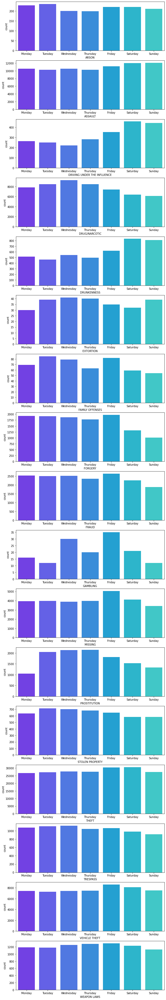

In [ ]:
grouped = a.groupby('Category')[['DayOfWeek', 'count']]
rows = a.Category.nunique()
fig, axes = plt.subplots(rows, 1, figsize=(10, 4*rows))
for i, (k, g) in enumerate(grouped):
  ax = sns.barplot(data=g, x='DayOfWeek',y='count', ax=axes[i])
  ax.set_xlabel(k)

17개의 범죄항목을 요일별 그래프를 그려 시각화하였다.

### 시간별

In [ ]:
ab= pd.DataFrame(train.groupby('Category')['Hour'].value_counts())

In [ ]:
ab.rename(columns={'Hour': 'count'}, inplace=True)
ab = ab.reset_index()
ab

,Category,Hour,count
0,ARSON,0,101
1,ARSON,2,100
2,ARSON,4,98
3,ARSON,22,94
4,ARSON,23,94
...,...,...,...
401,WEAPON LAWS,3,161
402,WEAPON LAWS,7,156
403,WEAPON LAWS,4,113
404,WEAPON LAWS,6,103


In [ ]:
ab.sort_values('Hour')

,Category,Hour,count
0,ARSON,0,101
351,TRESPASS,0,215
323,THEFT,0,8223
168,FORGERY,0,1852
120,EXTORTION,0,31
...,...,...,...
363,VEHICLE THEFT,23,3569
319,THEFT,23,10402
134,EXTORTION,23,8
162,FAMILY OFFENSES,23,13


시간과 범죄의 종류를 그룹화하였다.

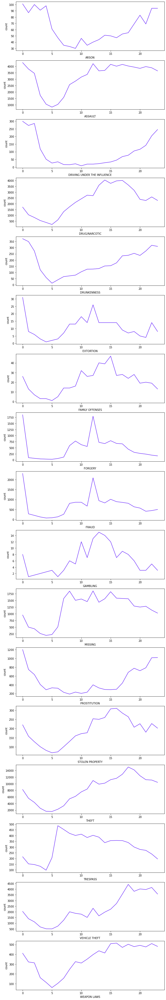

In [ ]:
grouped = ab.groupby('Category')[['Hour', 'count']]
rows = ab.Category.nunique()
fig, axes = plt.subplots(rows, 1, figsize=(10, 4*rows))
for i, (k, g) in enumerate(grouped):
  ax = sns.lineplot(data=g, x='Hour',y='count', ax=axes[i])
  ax.set_xlabel(k)

17개의 범죄항목을 시간별로 그래프를 그려 시각화하였다.

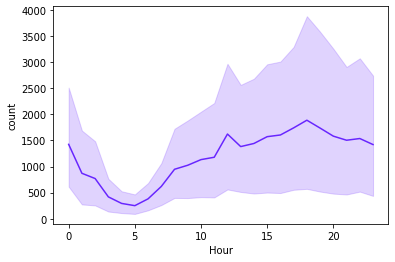

In [ ]:
sns.lineplot(data=ab,x='Hour',y='count')

17개의 강력범죄항목을 시간별로 그래프화하였는데, 39개의 범죄의 시간별 그래프와 비슷하였다. 그 중 범죄가 적은 5시와 범죄가 많이 나타난 12시와 18시를 기준으로 어떠한 범죄가 나타났는지 알아보았다. 

In [ ]:
tr_ct_hr = train[['Hour','Category']]

In [ ]:
a = tr_ct_hr.groupby(['Hour','Category']).size().to_frame().unstack(-1)
a = a.droplevel(0, axis =1)
a.columns

a.loc[[5]].T.sort_values(by = [5],ascending=False).head()

Hour,5
Category,
THEFT,1586.0
ASSAULT,825.0
VEHICLE THEFT,498.0
PROSTITUTION,330.0
MISSING,219.0


5시에는 절도, 살인, 차랑절도, 매춘, 실종이 많이 나타났다.

In [ ]:
a.loc[[12]].T.sort_values(by = [12],ascending=False).head()

Hour,12
Category,
THEFT,10949.0
ASSAULT,4207.0
DRUG/NARCOTIC,2696.0
VEHICLE THEFT,2313.0
FRAUD,2081.0


유동인구가 많은 12시는 절도, 살인, 마약, 차량절도, 사기가 많이 나타났다.

In [ ]:
a.loc[[18]].T.sort_values(by = [18],ascending=False).head()

Hour,18
Category,
THEFT,15043.0
VEHICLE THEFT,4417.0
ASSAULT,4025.0
DRUG/NARCOTIC,3619.0
MISSING,1561.0


유동인구가 많은 12시는 절도, 차량절도, 살인, 마약, 실종이 많이 나타났다.

### 해결방법별

In [ ]:
train['Resolution'].value_counts()

NONE                                      313697
ARREST, BOOKED                            108256
ARREST, CITED                              22776
LOCATED                                    15139
UNFOUNDED                                   4394
JUVENILE BOOKED                             3203
NOT PROSECUTED                              2766
DISTRICT ATTORNEY REFUSES TO PROSECUTE      2592
COMPLAINANT REFUSES TO PROSECUTE            1997
JUVENILE CITED                              1695
PROSECUTED BY OUTSIDE AGENCY                1673
EXCEPTIONAL CLEARANCE                        921
JUVENILE ADMONISHED                          750
PSYCHOPATHIC CASE                            571
CLEARED-CONTACT JUVENILE FOR MORE INFO       133
JUVENILE DIVERTED                            105
PROSECUTED FOR LESSER OFFENSE                 29
Name: Resolution, dtype: int64

In [ ]:
train_RD = train[(train.Resolution != 'UNFOUNDED')&(train.Resolution != 'JUVENILE BOOKED')&
                (train.Resolution != 'NOT PROSECUTED')&(train.Resolution != 'DISTRICT ATTORNEY REFUSES TO PROSECUTE')&
                (train.Resolution != 'COMPLAINANT REFUSES TO PROSECUTE')&(train.Resolution != 'JUVENILE CITED')&
                (train.Resolution != 'PROSECUTED BY OUTSIDE AGENCY')&(train.Resolution != 'EXCEPTIONAL CLEARANCE')&
                (train.Resolution != 'JUVENILE ADMONISHED')&(train.Resolution != 'PSYCHOPATHIC CASE')&
                (train.Resolution != 'CLEARED-CONTACT JUVENILE FOR MORE INFO')&(train.Resolution != 'JUVENILE DIVERTED')&
                (train.Resolution != 'PROSECUTED FOR LESSER OFFENSE')]

해결방안 중 상위 4개를 추출하였다.

In [ ]:
abc= pd.DataFrame(train_RD.groupby('Category')['Resolution'].value_counts())
abc

Resolution
Category      Resolution                
ARSON         NONE                  1248
              ARREST, BOOKED         203
              ARREST, CITED            7
ASSAULT       NONE                 44730
              ARREST, BOOKED       23446
...                                  ...
VEHICLE THEFT LOCATED                 10
WEAPON LAWS   ARREST, BOOKED        4853
              NONE                  2351
              ARREST, CITED          590
              LOCATED                  2

[65 rows x 1 columns]

17개의 강력범죄별 해결방안의 개수이다.

In [ ]:
abc.rename(columns={'Resolution': 'count'}, inplace=True)
abc = abc.reset_index()
abc

,Category,Resolution,count
0,ARSON,NONE,1248
1,ARSON,"ARREST, BOOKED",203
2,ARSON,"ARREST, CITED",7
3,ASSAULT,NONE,44730
4,ASSAULT,"ARREST, BOOKED",23446
...,...,...,...
60,VEHICLE THEFT,LOCATED,10
61,WEAPON LAWS,"ARREST, BOOKED",4853
62,WEAPON LAWS,NONE,2351
63,WEAPON LAWS,"ARREST, CITED",590


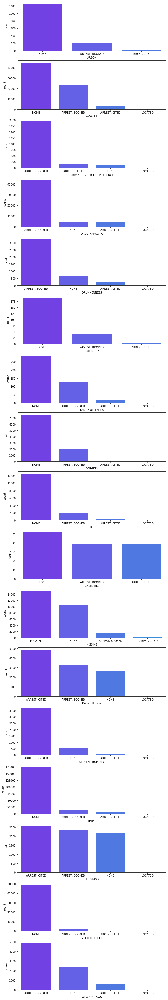

In [ ]:
grouped = abc.groupby('Category')[['Resolution', 'count']]
rows = abc.Category.nunique()
fig, axes = plt.subplots(rows, 1, figsize=(10, 4*rows))
for i, (k, g) in enumerate(grouped):
  ax = sns.barplot(data=g, x='Resolution',y='count', ax=axes[i])
  ax.set_xlabel(k)

'None'이 제일 많았지만, 모든 항목에서 None이 제일 많은 것은 아니다.

### 장소별

In [ ]:
import folium
from folium import plugins
from folium.plugins import HeatMap
from folium.plugins import FastMarkerCluster
from folium.plugins import MarkerCluster

In [ ]:
 m = folium.Map(
    location=[train.Y.mean(), train.X.mean()], #위도의 평균, 경도의 평균으로 맵을 그림
    tiles='Cartodb Positron',  #지도 타입?
    zoom_start=13   
)

marker_cluster = MarkerCluster(
    name='Crime Locations',
    overlay=True,  #겹쳐그림?
    control=False, 
    icon_create_function=None
)
for k in range(10000):
    location = train.Y.values[k], train.X.values[k]
    marker = folium.Marker(location=location,icon=folium.Icon(color='green'))
    popup = train.Category.values[k]  #Categroy를 넣으면 어떤범죄, addr를 넣으면 거리를 핑찍어줌 
    folium.Popup(popup).add_to(marker)
    marker_cluster.add_child(marker)

marker_cluster.add_to(m)

folium.LayerControl().add_to(m)

m.save("marker cluster south asia.html") #핑찍는?

m

위도와 경도를 이용하여 센프란시스코 지도위에 범죄수를 시각화하였다.
서부지역보다 동부지역에서 많은 범죄가 나타난다.

우범지역과 비교해봤을 때 일치한다고 볼 수 있다.